<span style="font-size: 14px;color:blue"><b>*This project*</b></span> focuses on analyzing crime patterns in Vancouver using weekly data from the Vancouver Police Department. The aim is to identify trends, locate crime hotspots, and understand how crime changes across the city over time.Employing Python for data analysis and creating an interactive report in Power BI, it offers valuable insights for community safety and law enforcement.

**This script conducts Exploratory Data Analysis (EDA) on the cleaned crime dataset, which has been saved as a binary file. Data preparation was carried out in the Python script 'VancouverCrimesAnalysis_DataPreparation.py'.**

  <span style="font-size: 22px;color:blue">1- Importing Libraries  </span>

In [1]:
import pandas as pd
import numpy as np
from IPython.display import display
import seaborn as sns
from datetime import datetime , timedelta
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from matplotlib.colors import LinearSegmentedColormap
import warnings
from IPython.core.display import display, HTML
import folium
from folium.plugins import HeatMap


  <span style="font-size: 22px;color:blue">2- Reading the data ( pickle files)  </span>

<span style="font-size: 16px;color:blue">2-1- Read the Crime data </span>

In [2]:
crime = pd.read_pickle('../Dataset/Prepared Data/crime_detailed_Prepared.pkl')
crime.head()
last_updatetime = crime.date.max()
crime_grouped_by_year_all = pd.read_pickle('../Dataset/Prepared Data/crime_grouped_by_year_all_Prepared.pkl')
crime_grouped_by_year_all.head()
crime_grouped_by_year_all_before2023 = crime_grouped_by_year_all[crime_grouped_by_year_all.YEAR < last_updatetime.year]
crime_curr = crime[crime.YEAR == last_updatetime.year]

<span style="font-size: 16px;color:blue">2-2- Read the Population data </span>

In [4]:
pop = pd.read_pickle('../Dataset/Prepared Data/VancouverPopulation_Prepared.pkl')
pop.head()


,growth,growthRate,population,year
0,24300,0.008285,2957471,2035
1,24431,0.008399,2933171,2034
2,24582,0.008523,2908740,2033
3,24751,0.008656,2884158,2032
4,24929,0.008795,2859407,2031


<span style="font-size: 16px;color:blue">2-3- Read the CPI data </span>

In [5]:
cpi = pd.read_pickle('../Dataset/Prepared Data/cpi_Prepared.pkl')
cpi.head()

,Year,All Items Index,Annual Percent Change
0,1971,21.4,NaN
1,1972,22.6,5.6
2,1973,24.2,7.1
3,1974,27.0,11.6
4,1975,30.0,11.1


<span style="font-size: 16px;color:blue">2-4- Create a dataframe for the crimes occured this year  </span>

In [6]:
crime_curr_year = crime[crime.YEAR == last_updatetime.year]
crime_curr_year.head()

,TYPE,YEAR,MONTH,DAY,HOUR,MINUTE,HUNDRED_BLOCK,NEIGHBOURHOOD,X,Y,...,holiday,weekday,weekday_name,month_name,day_type,time,time_category,crime_type_category,lon,lat
24,Break and Enter Commercial,2023,9,14,3,30,ALBERNI ST,West End,491065.2962,5.459130e+06,...,not_holiday,3,Thu,Sep,0,03:30:00,6-Midnight,Break and Enter,-123.122857,49.284853
101,Break and Enter Commercial,2023,4,1,4,7,BEACH AVE,West End,490197.8719,5.458239e+06,...,not_holiday,5,Sat,Apr,1,04:07:00,6-Midnight,Break and Enter,-123.134763,49.276827
134,Break and Enter Commercial,2023,4,3,0,50,BEACH AVE,Central Business District,490249.2307,5.458167e+06,...,not_holiday,0,Mon,Apr,0,00:50:00,6-Midnight,Break and Enter,-123.134055,49.276180
135,Break and Enter Commercial,2023,5,11,18,0,BEACH AVE,Central Business District,490249.2307,5.458167e+06,...,not_holiday,3,Thu,May,0,18:00:00,4-Evening,Break and Enter,-123.134055,49.276180
184,Break and Enter Commercial,2023,8,9,4,31,BEACH AVE,Central Business District,490268.4320,5.458143e+06,...,not_holiday,2,Wed,Aug,0,04:31:00,6-Midnight,Break and Enter,-123.133790,49.275963


<span style="font-size: 22px;color:blue">3.Exploring the data</span>


<span style="font-size: 16px;color:blue"> 3-1- How many crimes happend this year? </span>

In [7]:
print ( "The number of crimes in 2023 : {} ".format(len(crime_curr_year)))
( print ("And the number of crimes for the same period last year was :{}"
   .format(len(crime[(crime.YEAR == last_updatetime.year -1  ) &
                     (crime.date <= last_updatetime - timedelta(days=365) ) ]))) ) 
( print ("And the number of crimes for the same period last 2 year was :{}"
   .format(len(crime[(crime.YEAR == last_updatetime.year -2  ) &
                     (crime.date <= last_updatetime - timedelta(days=365) ) ]))) ) 


The number of crimes in 2023 : 32189 
And the number of crimes for the same period last year was :30747
And the number of crimes for the same period last 2 year was :30461


<span style="font-size: 16px;color:blue"> 3-2- What Is the Trend in Crime Rates Over the Years? Is the number of crimes decreasing?</span>

 
 >> The overall trend shows a decrease in the number of crimes over the years, with some fluctuations in between.The highest number of crimes was recorded in 2003, and there has been a general decline since then, reaching its lowest in 2021. However, there are years, like between 2011 and 2019, where we see some increase before it starts decreasing again.These fluctuations and potential causes need to be explored further.


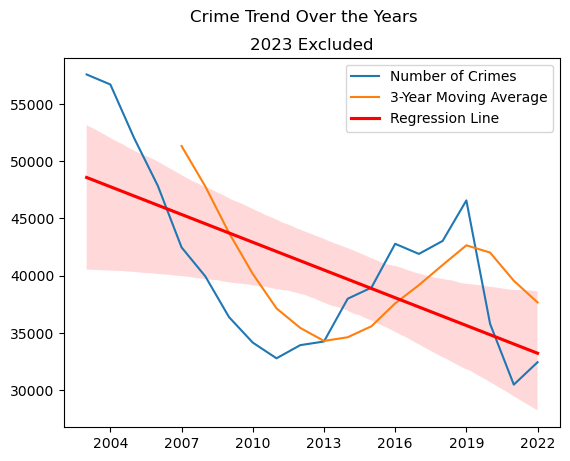

In [8]:
#display(crime_grouped_by_year_all_before2023[['YEAR', 'number_of_crimes']] )
print(""" \n >> The overall trend shows a decrease in the number of crimes over the years, with some fluctuations in between.\
The highest number of crimes was recorded in 2003, and there has been a general decline since then, \
reaching its lowest in 2021. However, there are years, like between 2011 and 2019, where we see some increase before it starts decreasing again.\
These fluctuations and potential causes need to be explored further.""") 
#Adding 3-year-moving average 
crime_grouped_by_year_all_before2023=crime_grouped_by_year_all_before2023.copy()
crime_grouped_by_year_all_before2023['moving_avg'] = crime_grouped_by_year_all_before2023.number_of_crimes.rolling(window = 5 ).mean()
sns.lineplot( data = crime_grouped_by_year_all_before2023 , x='YEAR' , y = 'number_of_crimes' , label='Number of Crimes')
sns.lineplot( data = crime_grouped_by_year_all_before2023 , x='YEAR' , y = 'moving_avg', label='3-Year Moving Average')
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
# Perform linear regression
sns.regplot(data=crime_grouped_by_year_all_before2023, x='YEAR', y='number_of_crimes', scatter=False, color='red', label='Regression Line')
plt.suptitle('Crime Trend Over the Years')
ax.set_title('2023 Excluded')
#plt.title('Crime Trend Over the Years- 2023 not included')
plt.xlabel('')
plt.ylabel('')
plt.legend(loc='best') 
plt.show()


 
 >> Both measurements show the same patterns, showing that crime rate changes aren't just because of changesin population. The crimes per capita metric adjusts for population size, suggesting that the actual rate of crime (relative to population size)has also decreased over time, particularly after 2003.


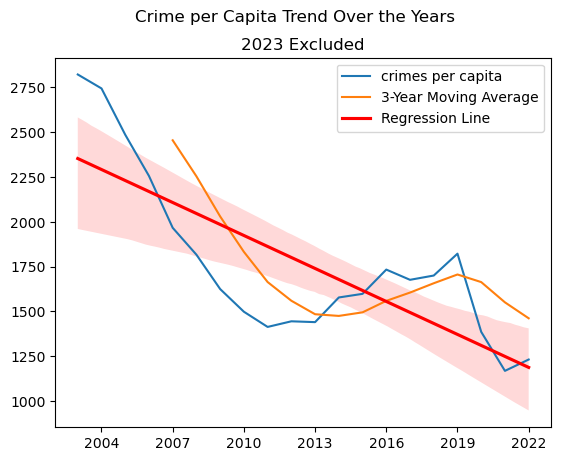

In [11]:
#display(crime_grouped_by_year_all_before2023[['YEAR', 'number_of_crimes']] )
print(""" \n >> Both measurements show the same patterns, showing that crime rate changes aren't just because of changes\
in population. The crimes per capita metric adjusts for population size, suggesting that the actual rate of crime (relative to population size)\
has also decreased over time, particularly after 2003.""")
#Adding 3-year-moving average 
crime_grouped_by_year_all_before2023=crime_grouped_by_year_all_before2023.copy()
crime_grouped_by_year_all_before2023['moving_avg'] = crime_grouped_by_year_all_before2023.crimes_per_capita.rolling(window = 5 ).mean()
sns.lineplot( data = crime_grouped_by_year_all_before2023 , x='YEAR' , y = 'crimes_per_capita' , label='crimes per capita')
sns.lineplot( data = crime_grouped_by_year_all_before2023 , x='YEAR' , y = 'moving_avg', label='3-Year Moving Average')
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
# Perform linear regression
sns.regplot(data=crime_grouped_by_year_all_before2023, x='YEAR', y='crimes_per_capita', scatter=False, color='red', label='Regression Line')
plt.suptitle('Crime per Capita Trend Over the Years')
ax.set_title('2023 Excluded')
#plt.title('Crime Trend Over the Years- 2023 not included')
plt.xlabel('')
plt.ylabel('')
plt.legend(loc='best') 
plt.show()


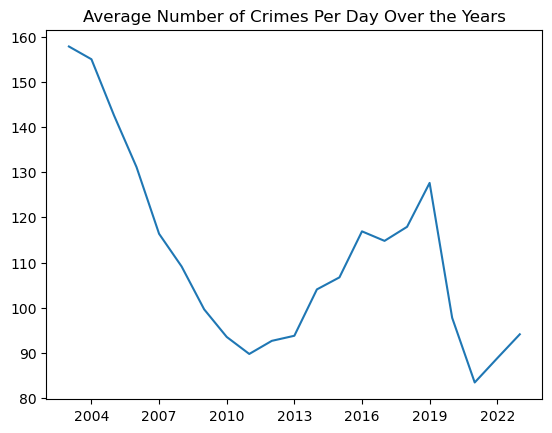

In [9]:
 sns.lineplot (data = crime
                  .groupby(['YEAR','date'])['TYPE']
                  .count()
                  .rename('crime_per_day')
                  .reset_index()
                  .groupby('YEAR')['crime_per_day']
                  .mean() 
                  
              )
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
plt.title('Average Number of Crimes Per Day Over the Years')
plt.xlabel('')
plt.ylabel('')
plt.show()

<span style="font-size: 12px;color:black">
 &bull; <i> From 2003 to 2009</i>, there was a consistant decrease in the average daily crimes.    
 <br>&bull; <i> From 2011 to 2019</i>, there was a trend of increasing average daily crimes. 
 <br>&bull; <i> Starting in 2019</i> , there was another decrease in the average number of daily crimes, 
 which continued through 2021. This decrease might be associated with  the COVID-19 pandemic.
 <br>&bull; <i> Rebound in 2022</i>, there was a slight increase in the average daily crime rate.
 This could indicate a potential rebound in criminal activity,

 But further analysis would be needed to understand the underlying causes.
 During the period from 2003 to 2021, several significant events and factors potentially influencing crime rates 
 <br>in Vancouver include:
 <br>&bull; 2010 Winter Olympics
 <br>&bull; Global Economic Recession (2008)
 <br>&bull; Drug Trade and Addiction Challenges
 <br>&bull; Social and Demographic Changes
 <br>A comprehensive analysis would require further access to data and a deeper examination
</span>

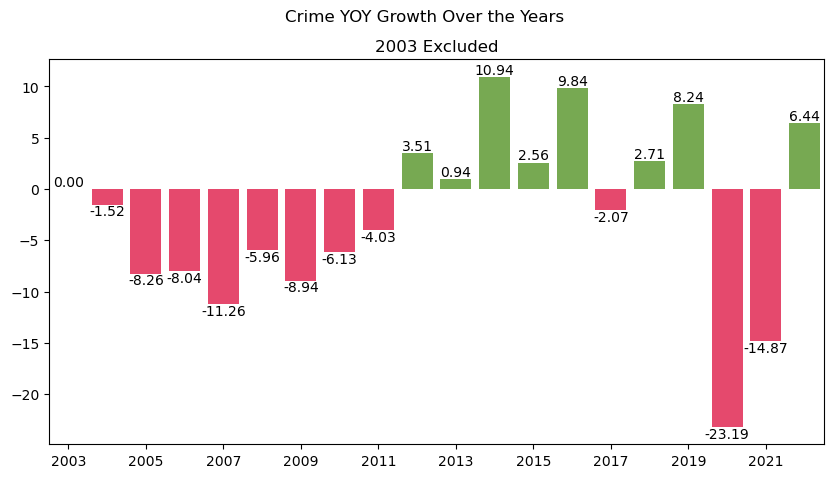

The crime growth rate has fluctuated over the years. The most remarkable decline happened in 2020, witnessing a 23% drop. This significant decrease could likely be attributed to the effects of the COVID-19 pandemic. Factors such as lockdowns or other restrictions might have played a role in deterring criminal activities. In 2022, there was a 6.5% increase, possibly signaling a return to pre-pandemic crime levels or patterns.

Let's see which crime types decreased more in 2020.


,crime_type_category,no_of_crimes_2020,no_of_crimes_2019,percent_changed
4,Theft,21917,32927,-33.437604
5,Vehicle Collision,859,1151,-25.369244
0,Break and Enter,4871,4759,2.353436
2,Mischief,6109,5833,4.731699
3,Offence Against a Person,2006,1899,5.634544
1,Homicide,19,12,58.333333


Theft and Vehicle Collision saw the largest declines in 2020, with decreases of 27% and 25%, respectively, compared to the previous year


In [10]:
# Determine colors based on y-values
colors = ['#75B744' if value > 0 else '#FF2F5F' for value in crime_grouped_by_year_all_before2023['crimes_growth_rate']]

plt.figure(figsize=(10,5))
sns.barplot( data = crime_grouped_by_year_all_before2023, x='YEAR' , y = 'crimes_growth_rate' , palette = colors)
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
plt.suptitle('Crime YOY Growth Over the Years')
#plt.title('Crime YOY Growth Over the Years - 2023 not included ' )
ax.set_title("2003 Excluded")
plt.xlabel('')
plt.ylabel('')

ax.bar_label(ax.containers[0],fmt="%.2f")
plt.show()
print("The crime growth rate has fluctuated over the years. The most remarkable decline happened in 2020, witnessing a 23% drop. This significant decrease could likely be attributed to the effects of the COVID-19 pandemic. Factors such as lockdowns or other restrictions might have played a role in deterring criminal activities. In 2022, there was a 6.5% increase, possibly signaling a return to pre-pandemic crime levels or patterns.")

print("\nLet's see which crime types decreased more in 2020.")
df_merged_1920 = ( crime[crime.YEAR==2020].
  groupby('crime_type_category')['TYPE'].
  count().rename('no_of_crimes_2020').
  to_frame().
  reset_index() 
).merge(crime[crime.YEAR==2019].
  groupby('crime_type_category')['TYPE'].
  count().rename('no_of_crimes_2019').
  to_frame().
  reset_index() )
df_merged_1920['percent_changed'] = (df_merged_1920['no_of_crimes_2020'] - df_merged_1920['no_of_crimes_2019']) / df_merged_1920['no_of_crimes_2019'] * 100
display(df_merged_1920.sort_values(by = 'percent_changed', ascending = True))
print('Theft and Vehicle Collision saw the largest declines in 2020, with decreases of 27% and 25%, respectively, compared to the previous year')

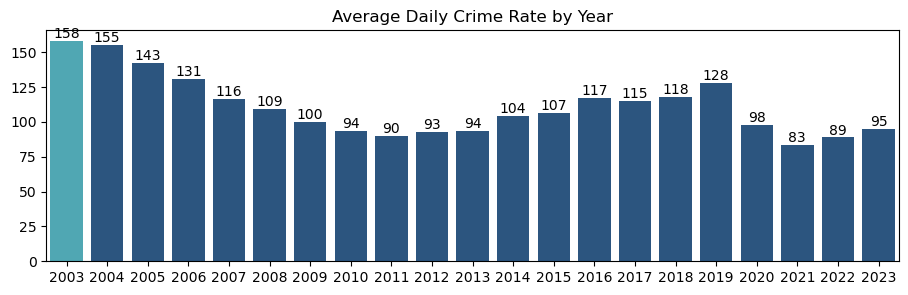


The daily average of crimes reported this year, up to the time this report was generated, has surpassed that of the prior year.


In [19]:
def days_in_year(year):
    if year == last_updatetime.year:
        start_of_year = datetime(last_updatetime.year, 1, 1)
        return (last_updatetime - start_of_year).days
    if (year % 4 == 0 and year % 100 != 0) or (year % 400 == 0):
        return 366
    else:
        return 365
crime_avg_daily = (crime
                     .groupby('YEAR')['TYPE']
                     .count()
                     .rename('crime_per_day')
                     .to_frame()
                     .reset_index()
                    )

crime_avg_daily['crime_per_day'] = round(crime_avg_daily['crime_per_day']/ crime_avg_daily['YEAR'].apply(days_in_year),2)
crime_avg_daily
plt.figure(figsize=(11,3))
max_value = crime_avg_daily['crime_per_day'].max()
colors = ['#3FB4C4' if v == max_value else '#1E558D' for v in crime_avg_daily['crime_per_day']]
sns.barplot(data = crime_avg_daily , x ='YEAR' , y = 'crime_per_day' , orient='v', palette = colors ) # palette="Blues" ) 
ax = plt.gca()
ax.set_title("Average Daily Crime Rate by Year")
plt.xlabel('')
plt.ylabel('')

ax.bar_label(ax.containers[0],fmt="%.f")
plt.show()
print("\nThe daily average of crimes reported this year, up to the time this report was generated, has surpassed that of the prior year.")

<span style="font-size: 16px;color:blue"> 3-3- Does Population Growth Correlate with Crime Rate? And How Does CPI Influence This?</span>

>>Correlation between Crime Rate and CPI (Consumer Price Index): 
There is a moderate to strong negative correlation between crimes per capita and the CPI index, as indicated by acorrelation coefficient of -0.75. This suggests that higher economic health (reflected by a higher CPI index) is associated with lower crimes per capita. 
 >>Correlation between Crime Rate and Population Growth:
The correlation between crime rate and population growth is very weak, as indicated by correlation coefficients of 0.09 for crimes per capita. 
These findings suggest that population growth has a minimal linear relationship with crime rates.
 In summary, the analysis indicates that economic factors (as reflected by the CPI) have a more noticeable
correlation with crime rates compared to population growth, which shows a very weak association with crime rates.


,crimes_growth_rate,crimes_per_capita,cpi_index,pop_growth_rate
crimes_growth_rate,1.000000,0.014185,0.124482,-0.196936
crimes_per_capita,0.014185,1.000000,-0.746847,0.085966
cpi_index,0.124482,-0.746847,1.000000,-0.595081
pop_growth_rate,-0.196936,0.085966,-0.595081,1.000000


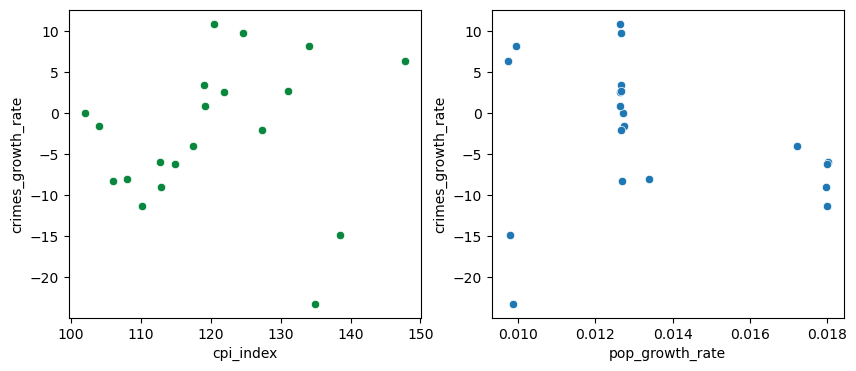

In [11]:
fig ,ax = plt.subplots(1,2 , figsize =(10,4))
sns.scatterplot(data = crime_grouped_by_year_all_before2023 , y='crimes_growth_rate' ,x ='cpi_index',ax=ax[0], color='#0A873F')
sns.scatterplot(data = crime_grouped_by_year_all_before2023 , y='crimes_growth_rate' ,x ='pop_growth_rate',ax=ax[1])

correlation_value_pop = "{:.2f}".format(crime_grouped_by_year_all_before2023['pop_growth_rate'].corr(crime_grouped_by_year_all_before2023['crimes_per_capita']))
correlation_value_cpi = "{:.2f}".format(crime_grouped_by_year_all_before2023['cpi_index'].corr(crime_grouped_by_year_all_before2023['crimes_per_capita']))

print(">>Correlation between Crime Rate and CPI (Consumer Price Index): \
\nThere is a moderate to strong negative correlation between crimes per capita and the CPI index, as indicated by a\
correlation coefficient of {}. This suggests that higher economic health (reflected by a higher CPI index) is associated \
with lower crimes per capita. \
\n >>Correlation between Crime Rate and Population Growth:\
\nThe correlation between crime rate and population growth is very weak, as \
indicated by correlation coefficients of {} for crimes per capita. \
\nThese findings suggest that population growth has a minimal linear relationship with crime rates.\
\n In summary, the analysis indicates that economic factors (as reflected by the CPI) have a more noticeable\
\ncorrelation with crime rates compared to population growth, which shows a very weak association with crime rates.".format(correlation_value_cpi,correlation_value_pop))
      
#print("There doesn't appear to be a strong relationship between the population growth rate and the crime rate,\
#nor between the change in the CPI index and the crime rate, as evidenced by correlations of around {} and {}, respectively.".format(correlation_value_pop,correlation_value_cpi ))

#print("\nWhile our analysis reveals no strong correlation between the crime rate and either the population growth rate, it's crucial to remember that crime is influenced by various factors not captured in this dataset. Comprehensive research is needed to unpack the complexities behind crime trends.")

crime_grouped_by_year_all_before2023[['crimes_growth_rate','crimes_per_capita','cpi_index','pop_growth_rate']].corr()

<span style="font-size: 16px;color:blue"> 3-4- How Has Crime Trended Over the Years by Crime Type?</span>


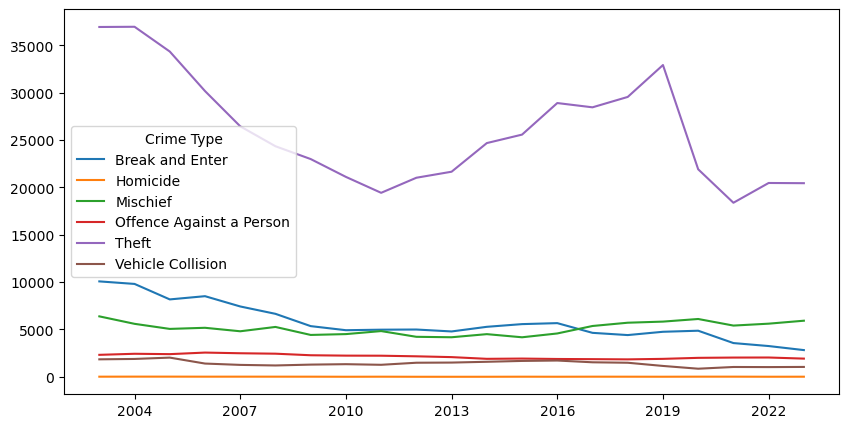

-Theft, despite its fluctuations, remains one of the most common crimes throughout the years.
-Homicide cases, although grave in nature, are relatively low and do not show a consistent upward or downward trend.
-The year 2020, likely influenced by the global pandemic and related restrictions, shows particular declines in several crime categories, most notably in theft and Vehicle Collision.


In [12]:
df = crime.groupby(['YEAR' ,'crime_type_category'])['TYPE'].count().rename('num_of_crimes').reset_index()
plt.figure(figsize=(10,5))
sns.lineplot(data  = df , x = 'YEAR' , y = 'num_of_crimes', hue ='crime_type_category')
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
leg = plt.legend()
leg.set_title('Crime Type')

plt.title= 'Crime Trends Over the Years by Crime Type'
plt.xlabel('')
plt.ylabel('')
plt.show()
print("-Theft, despite its fluctuations, remains one of the most common crimes throughout the years.\n"
"-Homicide cases, although grave in nature, are relatively low and do not show a consistent upward or downward trend.\n"
"-The year 2020, likely influenced by the global pandemic and related restrictions, shows particular declines in several crime categories, most notably in theft and Vehicle Collision.")



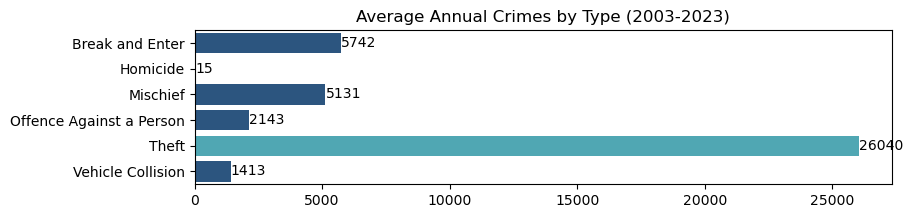

From 2003 to 2023, 'Theft' was the most frequent crime category averaging around 14,343 cases annually, while 'Homicide' was the least common with about 15 cases per year.


In [16]:
data = ( crime.
            groupby('crime_type_category')['TYPE'].
            count().
            rename('No_of_crimes').
            div(21).
            to_frame().
            reset_index()  
       )
   
plt.figure(figsize=(9,2))
max_value = data.No_of_crimes.max()
colors = ['#3FB4C4' if v == max_value else "#1E558D" for v in data['No_of_crimes']]
sns.barplot(data = data   ,
            y='crime_type_category',x ='No_of_crimes' , 
            palette= colors)

ax = plt.gca()
ax.set_title("Average Annual Crimes by Type (2003-2023)")
plt.xlabel('')
plt.ylabel('')

ax.bar_label(ax.containers[0],fmt="%.f")
plt.show()
print("From 2003 to 2023, 'Theft' was the most frequent crime category averaging around 14,343 cases annually, while 'Homicide' was the least common with about 15 cases per year.")

<span style="font-size: 16px;color:blue"> 3-5- Is There any Seasonality? </span>

<span style="font-size: 14px;color:blue">3-5-1- Which Months Witness Higher/Lower Crime Rates</span>

First, let's examine the average number of crimes per month over the years.


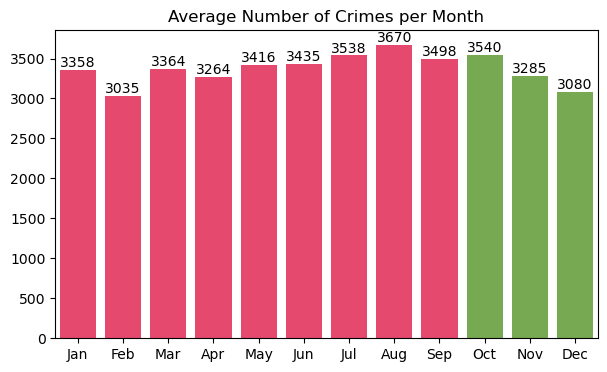

August appears to have the highest number of crimes, while February has the fewest.February typically has fewer days than other months, which can impact monthly crime statistics

Now, let's dig deeper to spot patterns in the monthly crime rates over the years.


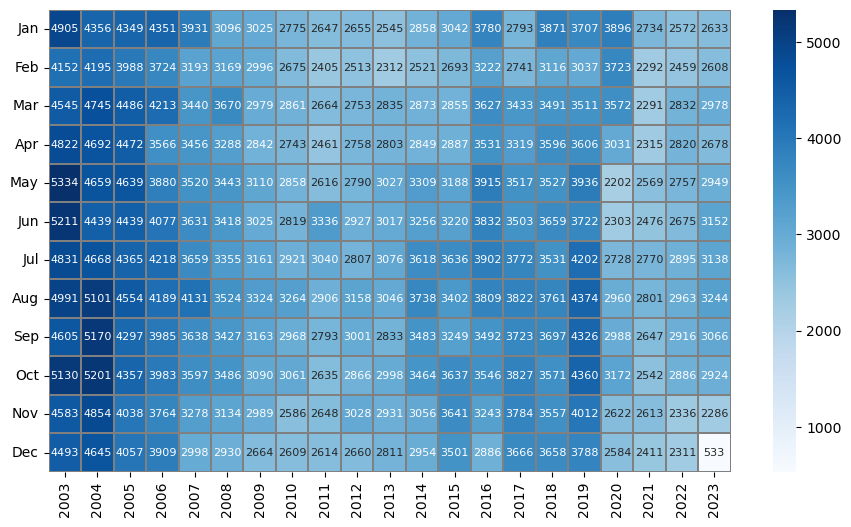

Crime rates generally peak during the warmer months of May to August, suggesting a potential link between crimerates and warmer weather and more outdoor activities. February often sees a decrease, possibly due to its shorter duration.Data for late 2023 appears incomplete.


In [13]:
# First I create a dataframe for monthly crimes 
print("First, let's examine the average number of crimes per month over the years.")
month_order = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul','Aug','Sep','Oct','Nov','Dec']
crime_momthly = crime.groupby(['YEAR','MONTH'])['TYPE'].count().rename('no_of_crimes').to_frame().reset_index()
crime_monthly_avg = (crime_momthly.
    groupby('MONTH')['no_of_crimes'].
    mean().
    rename('avg_no_of_crime').
    to_frame().
    reset_index()
)
 
plt.figure(figsize =(7,4))
sns.barplot(data =  crime_monthly_avg ,
            x ='MONTH' , 
            y = 'avg_no_of_crime',
            palette = colors,
) # lor = '#1E558D')
ax =plt.gca()
ax.set_title("Average Number of Crimes per Month")
plt.xlabel('')
plt.ylabel('')
ax.set_xticklabels(month_order)
ax.bar_label(ax.containers[0],fmt="%.f")
plt.show()
print("August appears to have the highest number of crimes, while February has the fewest.\
February typically has fewer days than other months, which can impact monthly crime statistics")
print("\nNow, let's dig deeper to spot patterns in the monthly crime rates over the years.")
plt.figure(figsize=(11,6))
sns.heatmap(data  = crime_momthly.pivot("MONTH" , "YEAR" , "no_of_crimes")  ,
            cmap='Blues' , # 'YlGnBu',
            linecolor='grey',
            linewidths=0.1,
            cbar=True, 
            annot=True ,
            fmt=".0f" ,
            annot_kws={"fontsize": 8},
            yticklabels=month_order
)
ax.set_title('Number of Crime per Month and Year ', fontsize=10)
plt.xlabel('')
plt.ylabel('')
plt.yticks(rotation=0)
plt.show()
print("Crime rates generally peak during the warmer months of May to August, suggesting a potential link between crime\
rates and warmer weather and more outdoor activities. \
February often sees a decrease, possibly due to its shorter duration.\
Data for late 2023 appears incomplete.")

<span style="font-size: 14px;color:blue"> 3-5-2- Which days seems to be more safe/dangerous ? </span>

count    7647.000000
mean      111.173794
std        28.683650
min         4.000000
25%        90.000000
50%       107.000000
75%       129.000000
max       679.000000
Name: no_of_crimes, dtype: float64

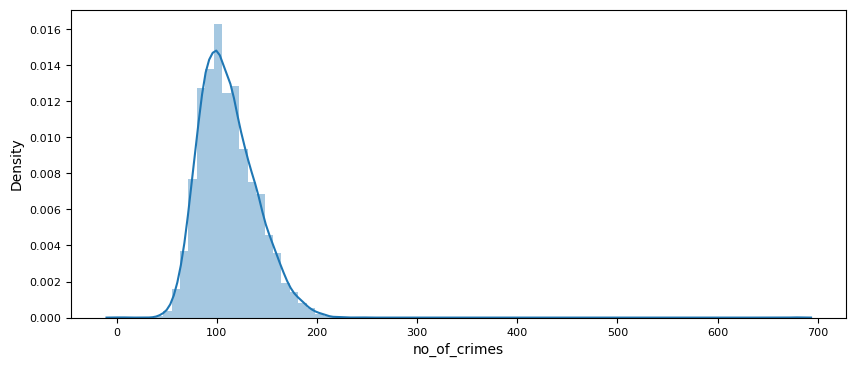

-The distribution appears to be normal, based on visual inspection, with a mean of 112 crimes per day.
-Half of the days had between 91 and 129 crimes.
-The peak day witnessed a significantly higher 678 crimes.

Let's investigate the specific date with such a high number of crimes! 🕵‍♂️
           holiday  weekday
10991  not_holiday        2
On June 6, 2011, we observed 678 crimes, which is 500% above the average of 112 crimes per day.
To investigate the possible reasons for this extreme variation, I conducted a search for significant events or
factors that may have contributed to this specific day in Vancouver's history.
According to the 


in June 2011, a riot erupted in Vancouver during the Stanley Cup finals.
The trouble began when it seemed the home team wouldn't win the championship. Disappointed fans turned to rioting and in five hours of rioting, members of the crowd committed multiple criminal offenses, including arson, break and enter,theft, mischief, and assault.
Approximately 55,000 people watched the game at a public viewing area on West Georgia Street, with an additional 100,000 people      in the streets surrounding these viewing areas.

Here's a breakdown of the crime types that occurred on that day.... 
crime_type_category
Mischief                    372
Break and Enter             187
Theft                       111
Offence Against a Person      7
Vehicle Collision             2
Name: TYPE, dtype: int64


... and the neighborhoods most affected.
NEIGHBOURHOOD
Central Business District    580
Strathcona                    20
Mount Pleasant                14
West End                      13
Fairview        

In [14]:
display(HTML("<style>div.output_scroll { height: auto; }</style>"))
warnings.filterwarnings('ignore')
crime_per_day  = crime.groupby('date')['TYPE'].count().rename('no_of_crimes')
display(crime_per_day.describe())
plt.figure(figsize=(10,4))
ax.set_title('Distribution of Crimes per day', fontsize=10)
plt.tick_params(labelsize=8)
#sns.distplot( crime.groupby('date')['TYPE'].count().rename('number_of_crimes_per_day') , bins = 80 ) ;
sns.distplot( crime_per_day , bins = 80 ) ;
plt.show()
print("-The distribution appears to be normal, based on visual inspection, with a mean of 112 crimes per day."
      "\n-Half of the days had between 91 and 129 crimes."
      "\n-The peak day witnessed a significantly higher 678 crimes.")


print("\nLet's investigate the specific date with such a high number of crimes! \U0001F575\u200D\u2642\uFE0F")
crime_per_day = crime_per_day.to_frame().reset_index()
q25 , q50 , q75 = np.percentile(crime_per_day.no_of_crimes,(25,50,75))
iqr = q75 - q25 
min_crime = q25 - 1.5 * iqr 
max_crime = q75 + 1.5 * iqr 
q25 , q50 , q75  , min_crime , max_crime , crime_per_day.no_of_crimes.min() , crime_per_day.no_of_crimes.max()
crime_outlier = crime_per_day[  crime_per_day.no_of_crimes > max_crime ].sort_values(by = 'no_of_crimes', ascending = False)
crime_outlier # .holiday.value_counts()
print(crime[crime.date=='2011-06-15'][['holiday','weekday']].drop_duplicates())

print("On June 6, 2011, we observed 678 crimes, which is 500% above the average of 112 crimes per day."
"\nTo investigate the possible reasons for this extreme variation, I conducted a search for significant events or" 
"\nfactors that may have contributed to this specific day in Vancouver's history."
"\nAccording to the ")
display(HTML('<a href="https://www2.gov.bc.ca/assets/gov/law-crime-and-justice/criminal-justice/prosecution-service/reports-publications/stanley-cup-riot-prosecutions.pdf", target="_blank">Stanley Cup Riot Prosecutions Report (PDF)</a>'))
print("in June 2011, a riot erupted in Vancouver during the Stanley Cup finals."
      "\nThe trouble began when it seemed the home team wouldn't win the championship. Disappointed fans turned to rioting \
and in five hours of rioting, members of the crowd committed multiple criminal offenses, including arson, break and enter,\
theft, mischief, and assault."
      "\nApproximately 55,000 people watched the game at a public viewing area on West Georgia Street, with an additional 100,000 people\
      in the streets surrounding these viewing areas.")
print("\nHere's a breakdown of the crime types that occurred on that day.... ")
print(crime[crime.date=='2011-06-15'].groupby('crime_type_category')['TYPE'].count().sort_values(ascending = False))
print("\n\n... and the neighborhoods most affected.")
print(crime[crime.date=='2011-06-15'].groupby('NEIGHBOURHOOD')['TYPE'].count().sort_values(ascending = False))


### Now let's move forward and see which days seems to be more dangerous/safe! will consider June 15, 2011, as an anomaly and remove it from the analysis.

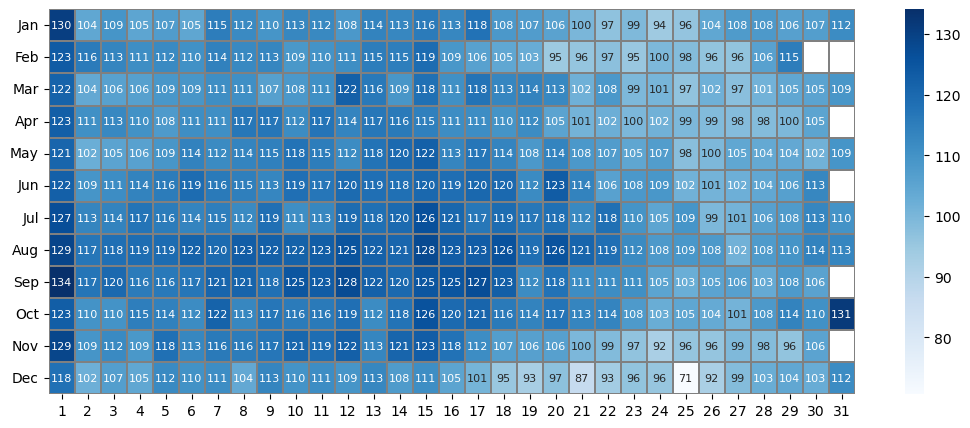

Some days stand out in terms of safety and danger:
  -Christmas Day, with only 71 crimes, which is 36% below the average of 112, seems to be the safest day in Vancouver.
  -September 1st (Labour Day), recording 134 crimes, Halloween on October 31st with 131 crimes, and New Year's Day
  with 130 crimes, are days with high crime rates. These figures are 18% above the average.
  -Summer seems to be more busy specially the first two weeks of the month.
  -In many months, the first half, tends to experience a higher crime rate compared to the latter half. 
   This trend might be influenced by factors like payday cycles, social events, or other external influences, which would
   require further investigation to pinpoint.
  -Across all months, the first day consistently registers crime rates ranging from 120 to 134 incidents, which is above the average.


In [15]:
d =(crime[crime.date != '2011-06-15'].
    groupby(['MONTH','DAY','date'])['TYPE'].
    count().
    rename('no_of_crime_per_day').
    to_frame().
    reset_index().
    groupby(['MONTH','DAY'])['no_of_crime_per_day'].
    mean().
    rename('no_of_crime_per_day').
    to_frame().
    reset_index()
)

plt.figure(figsize=(13,5))
sns.heatmap(data  = d.pivot("MONTH" , "DAY" , "no_of_crime_per_day")  ,
            cmap='Blues',#'YlGnBu',
            linecolor='grey',
            linewidths=0.1,
            cbar=True, 
            annot=True ,
            fmt=".0f" ,
            annot_kws={"fontsize": 8},
            yticklabels=month_order
)
ax.set_title('Number of Crime per Month and DAYXXX ', fontsize=10)
plt.xlabel('')
plt.ylabel('')
plt.yticks(rotation=0)
plt.show()
print ("Some days stand out in terms of safety and danger:"
       "\n  -Christmas Day, with only 71 crimes, which is 36% below the average of 112, seems to be the safest day in Vancouver."
       "\n  -September 1st (Labour Day), recording 134 crimes, Halloween on October 31st with 131 crimes, and New Year's Day"
       "\n  with 130 crimes, are days with high crime rates. These figures are 18% above the average."
       "\n  -Summer seems to be more busy specially the first two weeks of the month."
       "\n  -In many months, the first half, tends to experience a higher crime rate compared to the latter half. "
       "\n   This trend might be influenced by factors like payday cycles, social events, or other external influences, which would"
       "\n   require further investigation to pinpoint."
       "\n  -Across all months, the first day consistently registers crime rates ranging from 120 to 134 incidents, which is above the average.")

<span style="font-size: 16px;color:blue"> 3-5-3- Is there an evident monthly crime pattern by day of the week? </span>

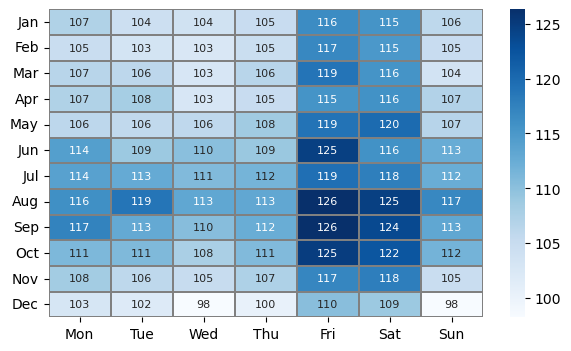

Crime rates peak during Fridays and Saturdays across all months, with both days consistently seeing higher numbers. In contrast, Wednesdays and Thursdays tend to have the lowest crime rates. 


In [16]:
weekday_order = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
d =(crime[crime.date != '2011-06-15'].
    groupby(['MONTH','weekday','date'])['TYPE'].
    count().
    rename('no_of_crime_per_weekday').
    to_frame().
    reset_index().
    groupby(['MONTH','weekday'])['no_of_crime_per_weekday'].
    mean().
    rename('no_of_crime_per_weekday').
    to_frame().
    reset_index()
)

plt.figure(figsize=(7,4))
sns.heatmap(data  = d.pivot("MONTH" , "weekday" , "no_of_crime_per_weekday")  ,
            cmap='Blues' , #'YlGnBu',
            linecolor='grey',
            linewidths=0.1,
            cbar=True, 
            annot=True ,
            fmt=".0f" ,
            annot_kws={"fontsize": 8},
            yticklabels=month_order,
            xticklabels=weekday_order
)
ax.set_title('Number of Crime per Month and Weekday ', fontsize=10)
plt.xlabel('')
plt.ylabel('')
plt.yticks(rotation=0)
plt.show()
print("Crime rates peak during Fridays and Saturdays across all months, with both days consistently seeing higher \
numbers. In contrast, Wednesdays and Thursdays tend to have the lowest crime rates. ")
      

<span style="font-size: 16px;color:blue"> 3-5-4- What are the peak and off-peak crime periods during the week, and how do they vary by day? </span>

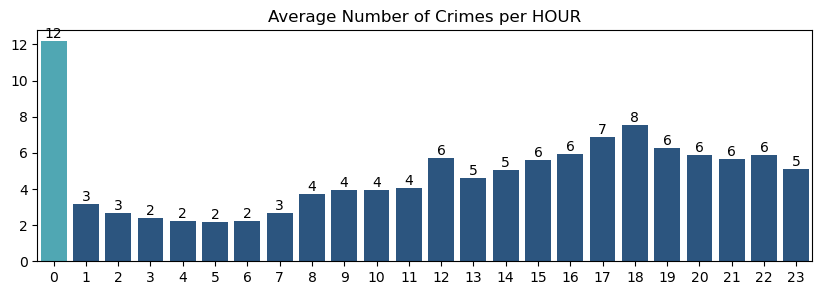

At midnight (0 hour), there's a notable spike in the average number of crimes. 
This surge, identified as an outlier in our boxplot analysis and could possibly be due to data entry errors,
where incidents around midnight are systematically recorded precisely at 12.
To provide a clearer analysis and avoid potential discrepancies related to hourly data, I've decided to use time categories instead.


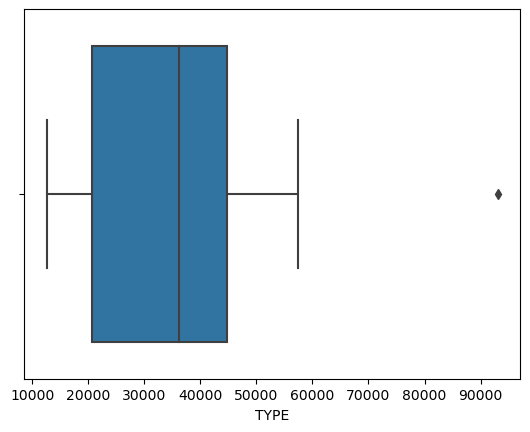

In [17]:

data = (crime[crime.date != '2011-06-15'].
        groupby(['date','HOUR'])['TYPE'].
        count().
        rename('crime_per_hour').
        reset_index().
        groupby('HOUR')['crime_per_hour'].
        mean().
        rename('crime_per_hour').
        to_frame().
        reset_index().
        sort_values(by='HOUR',ascending = True)
)
max_value = data.crime_per_hour.max()
colors = ['#3FB4C4' if v == max_value else "#1E558D" for v in data['crime_per_hour']]
plt.figure(figsize=(10,3))
sns.barplot(data = data  , x='HOUR' , y='crime_per_hour' , palette =colors )
ax = plt.gca()
ax.set_title("Average Number of Crimes per HOUR")
plt.xlabel('')
plt.ylabel('')

ax.bar_label(ax.containers[0],fmt="%.f")
plt.show()
sns.boxplot(crime.groupby('HOUR')['TYPE'].count())

print("At midnight (0 hour), there's a notable spike in the average number of crimes. "
      "\nThis surge, identified as an outlier in our boxplot analysis and could possibly be due to data entry errors,"
      "\nwhere incidents around midnight are systematically recorded precisely at 12."
       "\nTo provide a clearer analysis and avoid potential discrepancies related to hourly data, I've decided to use time categories instead.")




#### Shifting the Lense: Analysis by  Time Category

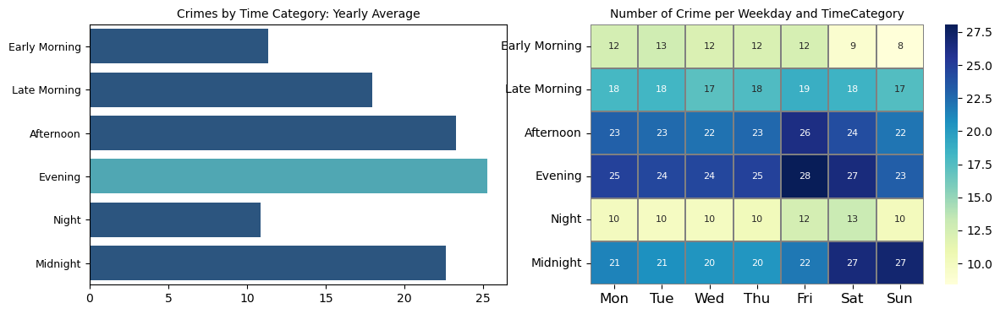

Crimes mostly occur in the evenings. On Saturdays and Sundays, crimes tend to occur at midnight,
while Friday afternoons also see a high number of crimes.
The night and early morning hours have the lowest number of crimes.


In [18]:
time_category_order = ['Early Morning', 'Late Morning', 'Afternoon', 'Evening','Night', 'Midnight']
d1 =(crime[crime.date != '2011-06-15'].
    groupby(['weekday','time_category','date'])['TYPE'].
    count().
    rename('no_of_crime_per_timecategory').
    to_frame().
    reset_index().
    groupby(['weekday','time_category'])['no_of_crime_per_timecategory'].
    mean().
    rename('no_of_crime_per_timecategory').
    to_frame().
    reset_index()
)

d2 = ( crime.
         groupby(['date','time_category'])['TYPE'].
         count().
         rename('no_of_crime').
         to_frame().
         groupby('time_category')['no_of_crime'].
         mean().
         rename('avg_no_of_crime').
         reset_index()
     )
         
fig ,ax = plt.subplots(1,2 , figsize =(14,4))
#***************
max_value = d2.avg_no_of_crime.max()
colors = ['#3FB4C4' if v == max_value else "#1E558D" for v in d2['avg_no_of_crime']]
sns.barplot(data = d2 ,
            y='time_category' ,
            x ='avg_no_of_crime' , 
            palette = colors, 
            ax=ax[0] )
          
ax[0].set_yticklabels(time_category_order)
ax[0].set_title("Crimes by Time Category: Yearly Average",fontsize=10)
ax[0].set_xlabel('')
ax[0].set_ylabel('')
ax[0].tick_params(axis='y', labelsize=9)
sns.heatmap(data  = d1.pivot("time_category" , "weekday" , "no_of_crime_per_timecategory")  ,
            cmap='YlGnBu',
            linecolor='grey',
            linewidths=0.1,
            cbar=True, 
            annot=True ,
            fmt=".0f" ,
            annot_kws={"fontsize": 8},
            yticklabels=time_category_order,
            xticklabels=weekday_order,
            ax=ax[1]
)
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].tick_params(axis='x', labelsize=12)
ax[1].set_title("Number of Crime per Weekday and TimeCategory",fontsize=10)
#plt.title('Number of Crime per Weekday and TimeCategory', fontsize=10)

plt.yticks(rotation=0)
plt.show()
print ("Crimes mostly occur in the evenings. On Saturdays and Sundays, crimes tend to occur at midnight,\nwhile Friday afternoons also see a high number of crimes.\nThe night and early morning hours have the lowest number of crimes.")

<span style="font-size: 16px;color:blue"> Let's see what type of crime occurs at the weekend's midnights the most? </span>
<br><span style="font-size: 16px;color:blue"> And take a look at Friday's evenings. what typically happens during Friday evenings? </span>

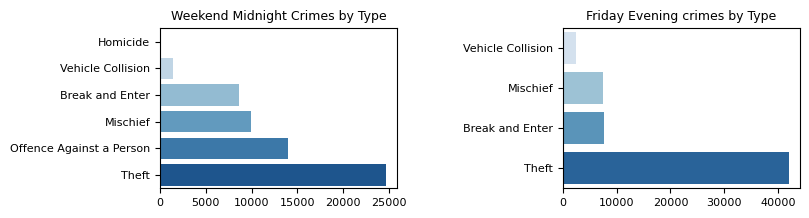

The most frequently occurring crime during weekend midnight hours is theft and offense against a person.
This trend may be attributed to an increase in nightlife activities, a rise in alcohol and drug consumption,
as well as reduced police presence. Further investigation is needed to better understand the underlying causes 

On Friday afternoon and evenings, theft is the most commonly occurring crime.


In [19]:
 
    fig, axes = plt.subplots (1, 2, figsize=(8, 2) )
   # plt.figure(figsize=(6, 4))
    plt.subplots_adjust(left=0.1,
                bottom=0.1,
                    right=0.9,
                    top=0.9,
                    wspace=0.7,
                    hspace=0.4)
    sns.barplot(ax=axes[0],  data = crime[(crime.time_category == '6-Midnight') & ((crime.weekday == 5) | (crime.weekday == 6))]
                        .groupby('crime_type_category')['TYPE']
                        .count()
                        .rename('number of crimes')
                        .reset_index()
                        .sort_values(by='number of crimes', ascending = True)
         ,  y='crime_type_category',x='number of crimes',palette="Blues" )
    
    
    sns.barplot(ax=axes[1],  data = crime[((crime.time_category == '4-Evening') | (crime.time_category == '3-Afternoon') )& (crime.weekday == 4)]
                        .groupby('crime_type_category')['TYPE']
                        .count()
                        .rename('number of crimes')
                        .reset_index()
                        .sort_values(by='number of crimes', ascending = True)
         ,  y='crime_type_category',x='number of crimes',palette="Blues"   )
        
        
         

axes[0].set_title("Weekend Midnight Crimes by Type" , fontsize = 9)
axes[1].set_title("Friday Evening crimes by Type", fontsize = 9)
axes[0].set_xlabel('')
axes[0].set_ylabel('')
axes[1].set_xlabel('')
axes[1].set_ylabel('')
axes[0].tick_params(axis='both', labelsize=8)
axes[1].tick_params(axis='both', labelsize=8)
#plt.tight_layout(w_pad=5.0)
plt.show()
print ("The most frequently occurring crime during weekend midnight hours is theft and offense against a person.")
print("This trend may be attributed to an increase in nightlife activities, a rise in alcohol and drug consumption,\nas well as reduced police presence. Further investigation is needed to better understand the underlying causes ")
print ("\nOn Friday afternoon and evenings, theft is the most commonly occurring crime.")

<span style="font-size: 16px;color:blue"> 3-6- Delving into Crime Types:  </span>

<span style="font-size: 16px;color:blue">- 3-6-1-What is the top crime type for each year? </span> 

In [20]:
display(
            pd.DataFrame 
            (
            crime
                .groupby(['YEAR','TYPE'])['TYPE']
                .count()
                .sort_values(ascending=False)
                .groupby('YEAR')
                .head(1)
                .rename('Number of crimes')
                .to_frame()
                .reset_index()
            ).sort_values('YEAR' , ascending=False)
        )
print( """\n >> The crime types Theft from Vehicle and Other Theft consistently exhibit the highest number of incidents across the years.
    """ ) 

,YEAR,TYPE,Number of crimes
9,2023,Other Theft,11844
12,2022,Other Theft,10757
20,2021,Other Theft,8583
14,2020,Theft from Vehicle,10430
2,2019,Theft from Vehicle,17005
4,2018,Theft from Vehicle,14996
6,2017,Theft from Vehicle,12957
7,2016,Theft from Vehicle,12815
13,2015,Other Theft,10598
11,2014,Other Theft,10794



 >> The crime types Theft from Vehicle and Other Theft consistently exhibit the highest number of incidents across the years.
    


<span style="font-size: 16px;color:blue">- 3-6-2-What are the top 3 crime types this year and over the years? </span>

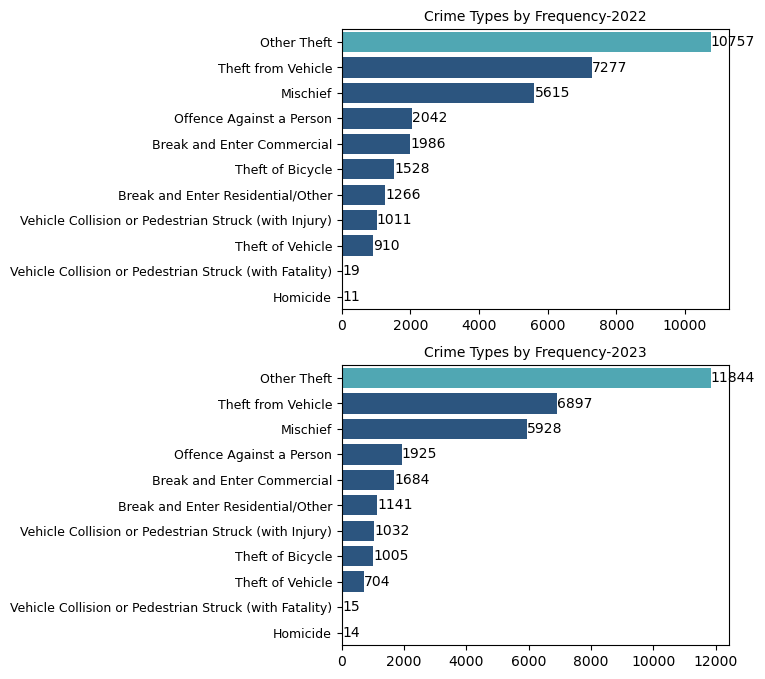

In [21]:
### *************** maybe remove 
crime_this_year = ( crime[crime.YEAR == last_updatetime.year].
                        groupby('TYPE')['TYPE'].
                        count().
                        rename('no_of_crimes').
                        to_frame().
                        reset_index().
                        sort_values(by = 'no_of_crimes' , ascending =False)
             )
crime_previous_year = ( crime[crime.YEAR == last_updatetime.year-1].
                        groupby('TYPE')['TYPE'].
                        count().
                        rename('no_of_crimes').
                        to_frame().
                        reset_index().
                        sort_values(by = 'no_of_crimes' , ascending =False)
             )
fig,ax=plt.subplots(2,1 , figsize=(5,8))
max_value = crime_previous_year.no_of_crimes.max()
colors = ['#3FB4C4' if v == max_value else "#1E558D" for v in crime_previous_year['no_of_crimes']]
sns.barplot(data = crime_previous_year ,
            x='no_of_crimes' ,
            y='TYPE',
            ax=ax[0],
            palette = colors)
max_value = crime_this_year.no_of_crimes.max()
colors = ['#3FB4C4' if v == max_value else "#1E558D" for v in crime_this_year['no_of_crimes']]
sns.barplot(data = crime_this_year ,
            x='no_of_crimes' ,
            y='TYPE',
            ax=ax[1],
            palette = colors)
ax[0].set_title("Crime Types by Frequency-2022",fontsize=10)
ax[0].set_xlabel('')
ax[0].set_ylabel('')
ax[0].tick_params(axis='y', labelsize=9)
ax[1].set_title("Crime Types by Frequency-2023",fontsize=10)
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[0].bar_label(ax[0].containers[0],fmt="%.f")
ax[1].bar_label(ax[1].containers[0],fmt="%.f")
ax[1].tick_params(axis='y', labelsize=9)
plt.show()

<span style="font-size: 16px;color:blue">- 3-6-3-Now let's see which crime type has the most percentage changes over the years : </span>

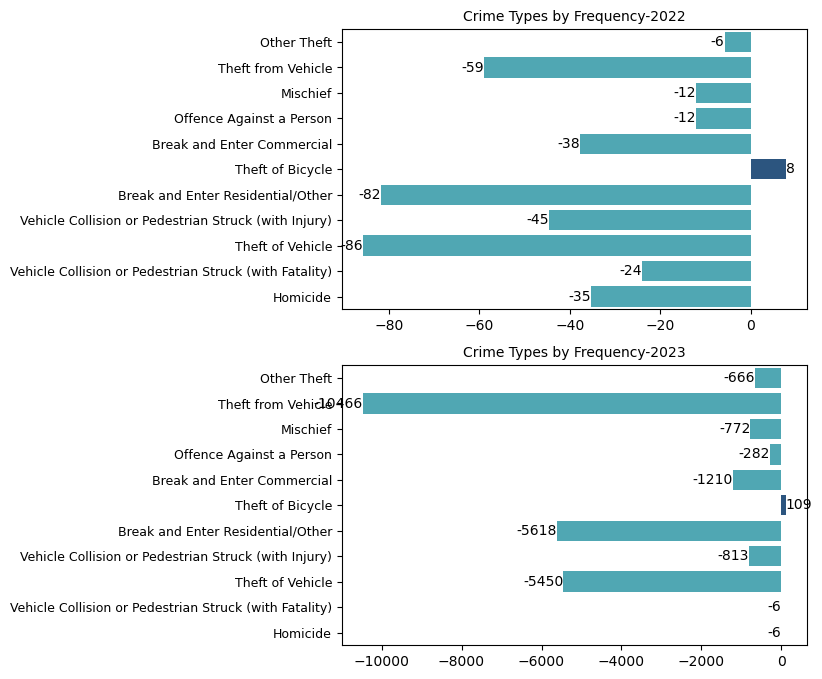

,TYPE,no_of_crimes_pre_year,no_of_crimes_first_year,percent_changed,absolute_changed
8,Theft of Vehicle,910,6360,-85.691824,-5450
6,Break and Enter Residential/Other,1266,6884,-81.609529,-5618
1,Theft from Vehicle,7277,17743,-58.986643,-10466
7,Vehicle Collision or Pedestrian Struck (with I...,1011,1824,-44.572368,-813
4,Break and Enter Commercial,1986,3196,-37.859825,-1210
10,Homicide,11,17,-35.294118,-6
9,Vehicle Collision or Pedestrian Struck (with F...,19,25,-24.000000,-6
3,Offence Against a Person,2042,2324,-12.134251,-282
2,Mischief,5615,6387,-12.087052,-772
5,Theft of Bicycle,1528,1419,7.681466,109


 Most crime types have seen a reduction, with 'Theft of Vehicle' and 'Break and Enter Residential/Other' witnessing the most significant declines. Only 'Theft of Bicycle' registered an increase in the number of cases. 
Over the years, advances in technology have made it more challenging for criminals to break into houses and steal vehicles. Modern vehicles, for instance, come equipped with advanced security systems, GPS tracking, immobilizers, and smart key access, making them harder to steal. Similarly, residential areas might have adopted better security systems,surveillance cameras, and stronger locks.Community Policing and Neighborhood Watch Programs: An active community policing initiative and the establishment ofneighborhood watch programs can significantly deter crimes in residential areas. When residents actively report suspicious activities and collaborate with the police, it can lead to a reduction in criminal activities like break-ins.


 It's interesting to note that while 

In [22]:
crime_previous_year.rename(columns ={'no_of_crimes':'no_of_crimes_pre_year'}, inplace =True)
crime_first_year = ( crime[crime.YEAR == crime.YEAR.min()].
                        groupby('TYPE')['TYPE'].
                        count().
                        rename('no_of_crimes_first_year').
                        to_frame().
                        reset_index().
                        sort_values(by = 'no_of_crimes_first_year' , ascending =False)
             )
crime_merged = crime_previous_year.merge(crime_first_year,how='inner', on='TYPE')
crime_merged['percent_changed'] = (crime_merged.no_of_crimes_pre_year - crime_merged.no_of_crimes_first_year) /crime_merged.no_of_crimes_first_year * 100
crime_merged['absolute_changed'] = (crime_merged.no_of_crimes_pre_year - crime_merged.no_of_crimes_first_year) 
###crime_merged
#***
fig,ax=plt.subplots(2,1 , figsize=(6,8))
#max_value = crime_merged.percent_changed.max()
colors = ['#3FB4C4' if v < 0  else "#1E558D" for v in crime_merged['percent_changed']]
sns.barplot(data = crime_merged ,
           x='percent_changed' ,
           y='TYPE',
           ax=ax[0],
           palette = colors)
max_value = crime_merged.absolute_changed.max()
colors = ['#3FB4C4' if v < 0  else "#1E558D" for v in crime_merged['absolute_changed']]
sns.barplot(data = crime_merged ,
            x='absolute_changed' ,
            y='TYPE',
            ax=ax[1],
            palette = colors)
ax[0].set_title("Crime Types by Frequency-2022",fontsize=10)
ax[0].set_xlabel('')
ax[0].set_ylabel('')
ax[0].tick_params(axis='y', labelsize=9)
ax[1].set_title("Crime Types by Frequency-2023",fontsize=10)
ax[1].set_xlabel('')
ax[1].set_ylabel('')
ax[1].tick_params(axis='y', labelsize=9)
ax[0].bar_label(ax[0].containers[0],fmt="%.f")
ax[1].bar_label(ax[1].containers[0],fmt="%.f")
plt.show()



crime_merged = crime_merged.iloc[crime_merged['percent_changed'].abs().argsort()[::-1]]
display(crime_merged)
print(" Most crime types have seen a reduction, with 'Theft of Vehicle' and 'Break and Enter Residential/Other' witnessing the most significant declines. Only 'Theft of Bicycle' registered an increase in the number of cases. ")
print("Over the years, advances in technology have made it more challenging for criminals to break into houses and steal \
vehicles. Modern vehicles, for instance, come equipped with advanced security systems, GPS tracking, immobilizers, and \
smart key access, making them harder to steal. Similarly, residential areas might have adopted better security systems,\
surveillance cameras, and stronger locks.\
Community Policing and Neighborhood Watch Programs: An active community policing initiative and the establishment of\
neighborhood watch programs can significantly deter crimes in residential areas. \
When residents actively report suspicious activities and collaborate with the police, it can lead to a reduction in \
criminal activities like break-ins.")
print("\n\n It's interesting to note that while severe crimes such as homicide have seen a reduction of 35.29% (from 17 cases to 11 cases)"
      "\nand vehicle collisions with fatalities have decreased by 24% (from 25 cases to 19 cases), some less severe crimes like "
      "\n'Theft of Bicycle' have seen an increase of 7.68% (from 1419 cases to 1528 cases). This contrast can be a point of interest"
      "\nfor further studies to understand the varying dynamics affecting different crime categories.")

<span style="font-size: 16px;color:black">what's the trend for this type of the crime? </span>

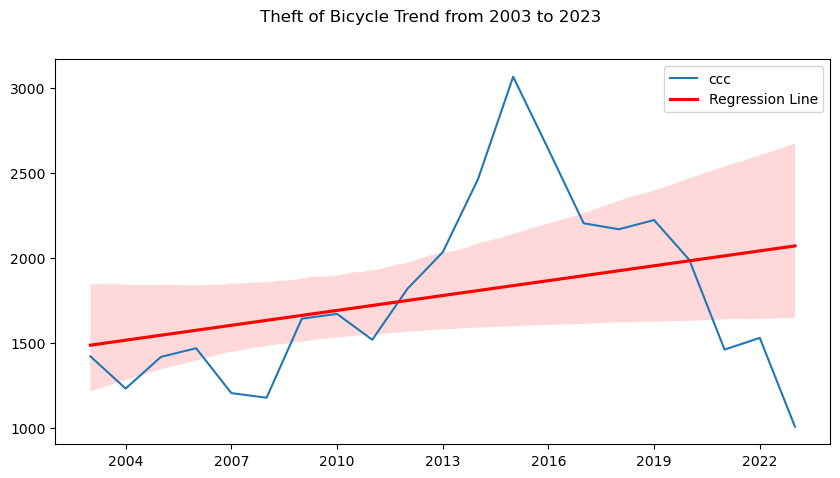

In summary, despite some years of decline and fluctuation, the long-term view from 2003 to 2023 indicates an overall positive trend in bicycle thefts, with the highest numbers recorded around 2015. Following this peak, there has been adecline. Let's delve deeper to see what could be the reasons behind this trend.
Bicycle thefts in Vancouver dropped by about 50% from 3,064 cases in 2015 to 1,528 in 2022.I looked into this decrease and learned about Project 529, a bike registration program that started in 2015.This big drop shows that Project 529 might be really helping to stop bike thefts.Registeratip app leads to significant decrease in bike theft

Now let's examine which neighbourhoods were most affected in 2023?


NEIGHBOURHOOD
Central Business District    232
Fairview                     144
West End                     126
Mount Pleasant               112
Kitsilano                     89
Grandview-Woodland            51
Strathcona                    49
Kensington-Cedar Cottage      39
Renfrew-Collingwood           27
Stanley Park                  20
Riley Park                    20
Marpole                       17
South Cambie                  13
West Point Grey               11
Hastings-Sunrise               9
Sunset                         9
Oakridge                       8
Killarney                      7
Arbutus Ridge                  7
Shaughnessy                    6
Kerrisdale                     4
Dunbar-Southlands              3
Victoria-Fraserview            2
dtype: int64


What times do these incidents occur most frequently?


time_category
3-Afternoon        247
4-Evening          226
2-Late Morning     182
6-Midnight         152
1-Early Morning    115
5-Night             83
dtype: int64

In [23]:
TheftOfBicycle_df = crime[ (crime.TYPE == 'Theft of Bicycle')  ]
data = TheftOfBicycle_df.groupby('YEAR')['TYPE'].count().rename('NumberOfCrimes').reset_index()
plt.figure(figsize=(10,5))
sns.lineplot( data = data , x='YEAR' , y = 'NumberOfCrimes', label='ccc')
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
# Perform linear regression
sns.regplot(data=data, x='YEAR', y='NumberOfCrimes', scatter=False, color='red', label='Regression Line')
plt.suptitle('Theft of Bicycle Trend from 2003 to 2023')
#ax.set_title('2023 Excluded')
#plt.title('Crime Trend Over the Years- 2023 not included')
plt.xlabel('')
plt.ylabel('')
plt.legend(loc='best') 
plt.show()
print("In summary, despite some years of decline and fluctuation, the long-term view from 2003 to 2023 indicates an overall \
positive trend in bicycle thefts, with the highest numbers recorded around 2015. Following this peak, there has been a\
decline. Let's delve deeper to see what could be the reasons behind this trend.")
TheftOfBicycle_2015 = data[data.YEAR == 2015]['NumberOfCrimes'].iloc[0]
TheftOfBicycle_2022 = data[data.YEAR == 2022]['NumberOfCrimes'].iloc[0]
#print(TheftOfBicycle_2015)
#print(TheftOfBicycle_2022)
ch =(TheftOfBicycle_2022-TheftOfBicycle_2015)/TheftOfBicycle_2015
print("Bicycle thefts in Vancouver dropped by about 50% from 3,064 cases in 2015 to 1,528 in 2022.\
I looked into this decrease and learned about Project 529, a bike registration program that started in 2015.\
This big drop shows that Project 529 might be really helping to stop bike thefts.Registeratip app leads to significant decrease in bike theft")
print("\nNow let's examine which neighbourhoods were most affected in 2023?")
display( crime[ (crime.TYPE == 'Theft of Bicycle') & (crime.YEAR == 2023)].value_counts('NEIGHBOURHOOD')) 
print("\nWhat times do these incidents occur most frequently?")
crime[ (crime.TYPE == 'Theft of Bicycle') & (crime.YEAR == 2023)].value_counts('time_category')

In [194]:
data

,YEAR,NumberOfCrimes
0,2003,1419
1,2004,1230
2,2005,1416
3,2006,1467
4,2007,1203
5,2008,1176
6,2009,1641
7,2010,1669
8,2011,1517
9,2012,1817


In [24]:
crime_2022_by_type = (
            crime[(crime.YEAR == last_updatetime.year - 1) & (crime.date <= last_updatetime - timedelta(days=365)) ].
            groupby('TYPE')['TYPE'].
            count().
            rename('number_of_crimes_2022').
            reset_index()
)
crime_2023_by_type = (
            crime[(crime.YEAR == last_updatetime.year) ].
            groupby('TYPE')['TYPE'].
            count().
            rename('number_of_crimes_2023').
            reset_index()
)
crime_2022_2023= crime_2022_by_type.merge(crime_2023_by_type)
crime_2022_2023['percent_changed'] =( crime_2022_2023.number_of_crimes_2023 - crime_2022_2023.number_of_crimes_2022 )/ crime_2022_2023.number_of_crimes_2022
crime_2022_2023['absolute_changed'] =( crime_2022_2023.number_of_crimes_2023 - crime_2022_2023.number_of_crimes_2022 )
display(crime_2022_2023.sort_values(by ='absolute_changed' , key=lambda x: x.abs(),  ascending = False ))
print("The comparison of crime types between 2022 and the same period in 2023 shows varied trends:\
Other Theft and Mischief have notably increased, with 1,636 and 599 more incidents, respectively.\
Significant decreases are seen in Theft of Bicycle (-483), Break and Enter Commercial (-190), and Theft of Vehicle (-170).\
Homicide incidents slightly increased, while Vehicle Collision or Pedestrian Struck categories show minor changes.\
This data indicates a shift in crime patterns, with increases in some types of property crimes and decreases in others.")

,TYPE,number_of_crimes_2022,number_of_crimes_2023,percent_changed,absolute_changed
5,Other Theft,10208,11844,0.160266,1636
3,Mischief,5329,5928,0.112404,599
7,Theft of Bicycle,1488,1005,-0.324597,-483
0,Break and Enter Commercial,1874,1684,-0.101387,-190
8,Theft of Vehicle,874,704,-0.194508,-170
10,Vehicle Collision or Pedestrian Struck (with I...,963,1032,0.071651,69
1,Break and Enter Residential/Other,1180,1141,-0.033051,-39
6,Theft from Vehicle,6865,6897,0.004661,32
4,Offence Against a Person,1936,1925,-0.005682,-11
9,Vehicle Collision or Pedestrian Struck (with F...,19,15,-0.210526,-4


The comparison of crime types between 2022 and the same period in 2023 shows varied trends:Other Theft and Mischief have notably increased, with 1,636 and 599 more incidents, respectively.Significant decreases are seen in Theft of Bicycle (-483), Break and Enter Commercial (-190), and Theft of Vehicle (-170).Homicide incidents slightly increased, while Vehicle Collision or Pedestrian Struck categories show minor changes.This data indicates a shift in crime patterns, with increases in some types of property crimes and decreases in others.


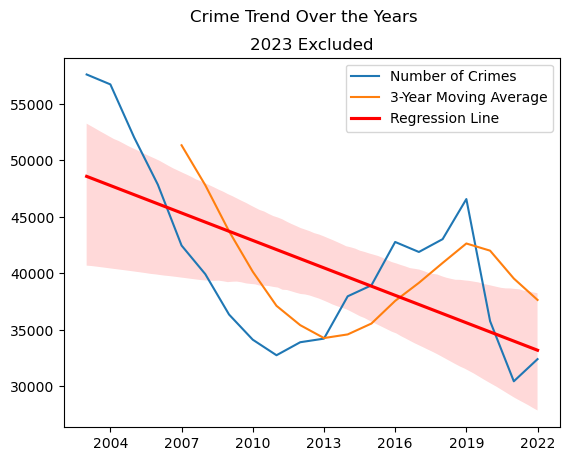

In [38]:
#Adding 3-year-moving average 
crime_grouped_by_year_all_before2023=crime_grouped_by_year_all_before2023.copy()
crime_grouped_by_year_all_before2023['moving_avg'] = crime_grouped_by_year_all_before2023.number_of_crimes.rolling(window = 5 ).mean()
sns.lineplot( data = crime_grouped_by_year_all_before2023 , x='YEAR' , y = 'number_of_crimes' , label='Number of Crimes')
sns.lineplot( data = crime_grouped_by_year_all_before2023 , x='YEAR' , y = 'moving_avg', label='3-Year Moving Average')
ax = plt.gca()
ax.xaxis.set_major_locator(MaxNLocator(integer=True))
# Perform linear regression
sns.regplot(data=crime_grouped_by_year_all_before2023, x='YEAR', y='number_of_crimes', scatter=False, color='red', label='Regression Line')
plt.suptitle('Crime Trend Over the Years')
ax.set_title('2023 Excluded')
#plt.title('Crime Trend Over the Years- 2023 not included')
plt.xlabel('')
plt.ylabel('')
plt.legend(loc='best') 
plt.show()

In [40]:
### *************** maybe remove 
# To show all the items without scrolling
#display(HTML("<style>div.output_scroll { height: auto; }</style>"))
#crime_grouped_by_type = crime.groupby(['YEAR','TYPE'])['TYPE'].count().rename('no_of_crimes').to_frame().reset_index()
#crime_grouped_by_type['crimes_growth_rate'] = (
#     ( crime_grouped_by_type['no_of_crimes'] - crime_grouped_by_type['no_of_crimes'].shift(1).fillna(0))
#       /       crime_grouped_by_type['no_of_crimes'].shift(1).fillna(1) 
#     ) * 100
#crime_grouped_by_type[(crime_grouped_by_type.YEAR == 2022)| (crime_grouped_by_type.YEAR == 2021 )]
##fig, axes = plt.subplots (len(crime_grouped_by_type.TYPE.unique()), 1, figsize=(8,10) )
#i=0
#for crime_type in crime_grouped_by_type.TYPE.unique():
#    df = crime_grouped_by_type[crime_grouped_by_type.TYPE  == crime_type]
#    plt.figure(figsize=(8, 2))
#    sns.barplot(data = df , x = 'YEAR' , y ='crimes_growth_rate', color = '#1E558D')
#        # Set chart title, labels, etc.
#   # plt.title(f'Percentage Change Over Years for {crime_type}')
#    plt.ylabel('Percentage Change')
#    plt.xlabel('Year')
#    plt.xticks(rotation=45)
    
#    plt.show()
#    i+=1

<span style="font-size: 16px;color:blue"> 3-6-4-Trend in Crime Rates for the Top 3 Crimes with the Highest Frequencies </span>

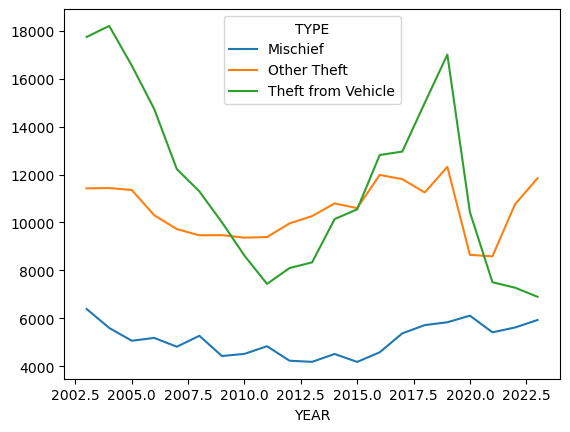

In [25]:
( crime[crime.TYPE.isin(['Theft from Vehicle','Other Theft','Mischief'])]
     .groupby(['YEAR','TYPE'])['TYPE']
     .count()
     .reset_index(name='num_of_crimes')
     .pivot(index='YEAR',columns='TYPE',values='num_of_crimes')
     .plot
     .line()
 );


<span style="font-size: 16px;color:blue"> 3-7- How Do Crime Patterns Vary Across Different Neighborhoods? </span>

<span style="font-size: 16px;color:blue">-3-7-1-Dangerous Hotspots: Average Annual Crime Rates by Neighbourhood</span>

In [26]:
crime_by_neighbourhood  = crime.groupby('NEIGHBOURHOOD')['TYPE'].count().reset_index(name='crime_count')
crime_by_neighbourhood
# Merge the crime counts with the neighborhood polygons
#merged_data = gdf_neighborhoods.merge(crime_count, on='NEIGHBOURHOOD', how='left')

,NEIGHBOURHOOD,crime_count
0,Arbutus Ridge,9397
1,Central Business District,222248
2,Dunbar-Southlands,11461
3,Fairview,53610
4,Grandview-Woodland,47143
5,Hastings-Sunrise,29884
6,Kensington-Cedar Cottage,40855
7,Kerrisdale,11530
8,Killarney,16434
9,Kitsilano,42719


,YEAR,NEIGHBOURHOOD,Number of crimes
11,2023,Central Business District,10345
13,2022,Central Business District,9593
19,2021,Central Business District,8215
14,2020,Central Business District,9446
0,2019,Central Business District,15045
1,2018,Central Business District,13650
2,2017,Central Business District,12746
3,2016,Central Business District,12654
9,2015,Central Business District,10622
12,2014,Central Business District,9917


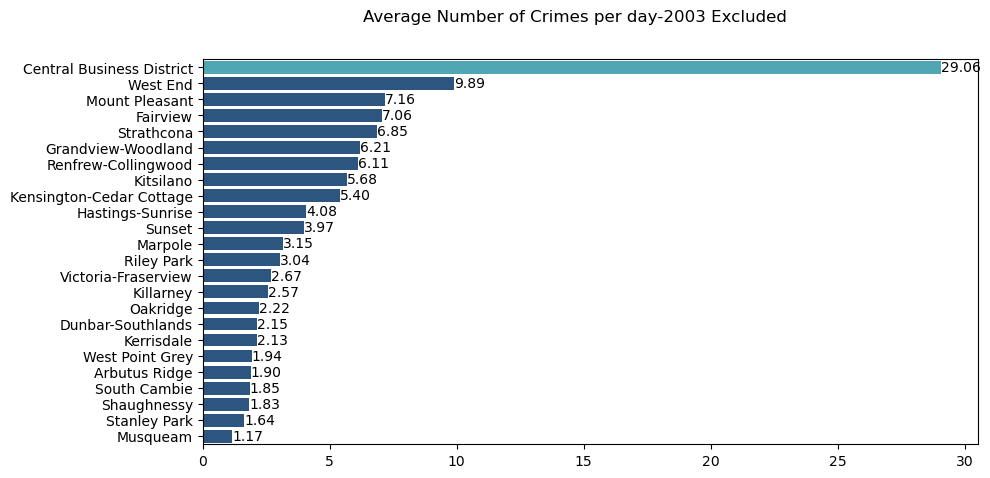


The Central Business District consistently ranks as the top neighbourhood with the highest number of reported crimes.Given its status as a commercial and cultural hub, it's expected to witness a higher frequency of crimes.
Quiet Neighborhoods: Arbutus Ridge, Musqueam, and Stanley Park have among the lowest average daily crime rates, hovering around1 to 2 crimes per day. 
These neighborhoods might be more residential or recreational, leading to fewer incidents.
Active Residential Areas: Neighborhoods like Fairview, Grandview-Woodland, Mount Pleasant, and Renfrew-Collingwood see higher averagesranging from 6 to 7 crimes per day, indicating these could be densely populated or have a mix of commercialand residential zones. 

West End's Distinction: The West End stands out with an average of nearly 10 crimes a day, making it second only to the CBD.Given itsvibrant mix of residential, commercial, and recreational spots, it's a hotspot of activity.
Stable Middle Ground: Neighborhoods such as

In [27]:
display(HTML("<style>div.output_scroll { height: auto; }</style>"))
display(pd.DataFrame( 
                crime.groupby(['YEAR' ,'NEIGHBOURHOOD'])['NEIGHBOURHOOD']
                        .count()
                        .sort_values(ascending=False)
                        .groupby('YEAR')
                        .head(1)
                        .rename('Number of crimes')
                        .to_frame()
                        .reset_index()
            ).sort_values('YEAR',ascending =False) ) 
### Let's see the average number of crimes per day in each neighbourhood 
data = (crime.
                         groupby(['NEIGHBOURHOOD','date'])['TYPE'].
                         count().
                         rename('no_of_crimes').
                         to_frame().
                         groupby('NEIGHBOURHOOD')['no_of_crimes'].
                         mean().
                         rename('Average Number of Crimes').
                         to_frame().
                         reset_index().
                         sort_values(by = 'Average Number of Crimes' , ascending  = False)

       )
plt.figure(figsize=(10,5))
max_value = data['Average Number of Crimes'].max()
colors = ['#3FB4C4' if v == max_value else '#1E558D' for v in data['Average Number of Crimes']]
sns.barplot ( data = data ,  
             x ='Average Number of Crimes' ,
             y = 'NEIGHBOURHOOD',
             orient = 'h' ,
             palette = colors
         
            ) ; 
ax.set_title("2003 Excluded")
plt.xlabel('')
plt.ylabel('')
plt.suptitle('Average Number of Crimes per day-2003 Excluded ')
ax = plt.gca()
ax.bar_label(ax.containers[0],fmt="%.2f")
plt.show()


print("""\nThe Central Business District consistently ranks as the top neighbourhood with the highest number of reported crimes.\
Given its status as a commercial and cultural hub, it's expected to witness a higher frequency of crimes.\
\nQuiet Neighborhoods: Arbutus Ridge, Musqueam, and Stanley Park have among the lowest average daily crime rates, hovering around\
1 to 2 crimes per day. \
\nThese neighborhoods might be more residential or recreational, leading to fewer incidents.\
\nActive Residential Areas: Neighborhoods like Fairview, Grandview-Woodland, Mount Pleasant, and Renfrew-Collingwood see higher averages\
ranging from 6 to 7 crimes per day, indicating these could be densely populated or have a mix of commercialand residential zones. 
\nWest End's Distinction: The West End stands out with an average of nearly 10 crimes a day, making it second only to the CBD.Given its\
vibrant mix of residential, commercial, and recreational spots, it's a hotspot of activity.\
\nStable Middle Ground: Neighborhoods such as Hastings-Sunrise, Kensington-Cedar Cottage, Kitsilano, and Sunset maintain a steady middle\
ground with averages between 3 to 6 crimes daily.""")


<span style="font-size: 16px;color:blue">3-7-2-Which Crime Type Occurs Most Frequently in Central Business District?</span>

In [28]:
display( crime[crime.NEIGHBOURHOOD == 'Central Business District' ].
    groupby(['crime_type_category','YEAR'])['TYPE'].
    count().
    rename('no_of_crimes').
    to_frame().
    groupby('crime_type_category')['no_of_crimes'].
    mean().
    rename('Average Number of Crimes per YEAR').
    to_frame().
    reset_index().
    sort_values(by = 'Average Number of Crimes per YEAR' , ascending = False)
)
print("In Vancouver's Central Business District, which experiences the highest crime rates, 'Theft' notably leads with\
an average of 4,341 crimes per year, followed by 'Mischief' and 'Break and Enter', while 'Homicide' remains relatively rare\ with an average of just under 4 cases annually.")

,crime_type_category,Average Number of Crimes per YEAR
4,Theft,7762.809524
2,Mischief,1416.380952
0,Break and Enter,849.428571
3,Offence Against a Person,338.666667
5,Vehicle Collision,212.285714
1,Homicide,3.850000


In Vancouver's Central Business District, which experiences the highest crime rates, 'Theft' notably leads withan average of 4,341 crimes per year, followed by 'Mischief' and 'Break and Enter', while 'Homicide' remains relatively rare\ with an average of just under 4 cases annually.


<span style="font-size: 16px;color:blue">3-7-3-Which days, what times?</span>

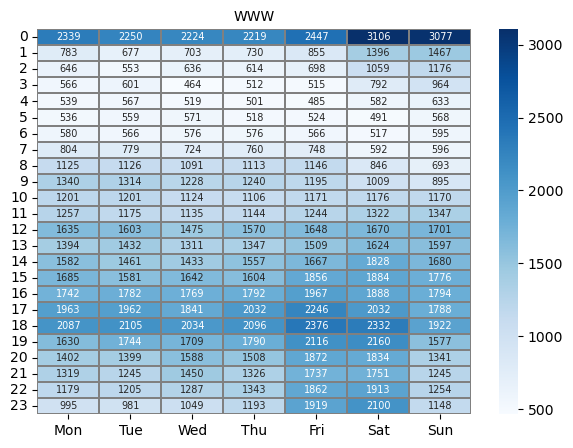

The Central Business District, has significant safety concerns, especially during the late-night hours and on weekends. 
 The hours from 6 PM to 8 PM, particularly from Tuesday to Friday, register high crime rates.


In [29]:
### what time which days
data = (
    crime[crime.NEIGHBOURHOOD == 'Central Business District' ].
    groupby(['HOUR' , 'weekday'])['TYPE'].
    count().
    rename('Number of Crimes').
    to_frame().
    reset_index()
)
  
fig , ax = plt.subplots(figsize=(7,5)) 
sns.heatmap(data  = data.pivot("HOUR" , "weekday" , "Number of Crimes")  ,
            cmap='Blues' , #YlGnBu',
            linecolor='grey',
            linewidths=0.05,
            cbar=True, 
            annot=True ,
            fmt=".0f" ,
            annot_kws={"fontsize": 7},
            xticklabels=weekday_order ,
            ax = ax 
)

ax.set_ylabel('')
ax.set_xlabel('')
ax.tick_params(axis='x', labelsize=10)
ax.set_title("WWW",fontsize=10)
#plt.title('Number of Crime per Weekday and TimeCategory', fontsize=10)

plt.yticks(rotation=0)
plt.show()
print("The Central Business District, has significant safety concerns, especially during the late-night hours and on weekends. "
     "\n The hours from 6 PM to 8 PM, particularly from Tuesday to Friday, register high crime rates.")

In [327]:
data.pivot("HOUR" , "weekday" , "Number of Crimes")

weekday,0,1,2,3,4,5,6
HOUR,,,,,,,
0,2338,2223,2219,2196,2423,3084,3050
1,777,668,695,724,844,1387,1461
2,640,545,635,611,696,1050,1170
3,562,600,460,506,511,787,955
4,536,565,516,497,478,576,632
5,531,556,566,516,523,490,567
6,575,560,571,573,562,513,588
7,802,778,721,759,744,588,591
8,1126,1120,1087,1108,1141,841,683


In [30]:
crime[crime.NEIGHBOURHOOD == 'Central Business District'].HUNDRED_BLOCK.value_counts()

GRANVILLE ST                 24926
W GEORGIA ST                 14271
SEYMOUR ST                   10526
W PENDER ST                  10183
W HASTINGS ST                 9763
                             ...  
BEATTY ST / CAMBIE ST            1
MAIN ST / E WATERFRONT RD        1
BEACH CRES / SEYMOUR ST          1
MAIN ST ONRP / MAIN ST           1
LENNOX PUB                       1
Name: HUNDRED_BLOCK, Length: 780, dtype: int64

In [31]:
import re
def extract_street_name(text):
    # Regular expression to find street patterns
    match = re.search(r'(\b\w+\b)\s(ST|AV|RD|DR|BLVD|LN|WAY|CT|PL|SQ|TRL|PKWY|CIR)', text, re.IGNORECASE)
    if match:
        return match.group(0)
    else:
        return None

# Copy the HUNDRED_BLOCK column to a new DataFrame
new_df = pd.DataFrame()
new_df['HUNDRED_BLOCK'] = crime['HUNDRED_BLOCK'].copy()

# Apply the function to extract street names
new_df['Street_Name'] = new_df['HUNDRED_BLOCK'].apply(extract_street_name)

# Drop rows where Street_Name is None (if needed)
new_df = new_df.dropna(subset=['Street_Name'])
#new_df.Street_Name.unique()
#unique_streets = crimetest['Street_Name'].dropna().unique()

<span style="font-size: 16px;color:blue">3-7-4-Which Crime Type Occurs Most Frequently in Each Neighborhood?</span>

In [32]:
print(">>>>In the curr year:")
display(
            crime_curr.
            groupby(['NEIGHBOURHOOD' , 'TYPE'])['TYPE'].
            count().
            sort_values(ascending = False).
            groupby('NEIGHBOURHOOD').
            head(1).
            rename('Number of Crimes').
            to_frame().
            reset_index())

    
print(">>>>Over the years:")
display(
            crime.
            groupby(['NEIGHBOURHOOD' , 'TYPE'])['TYPE'].
            count().
            sort_values(ascending = False).
            groupby('NEIGHBOURHOOD').
            head(1).
            rename('Number of Crimes ').
            to_frame().
            reset_index())

>>>>In the curr year:


,NEIGHBOURHOOD,TYPE,Number of Crimes
0,Central Business District,Other Theft,3922
1,Renfrew-Collingwood,Other Theft,1501
2,West End,Other Theft,927
3,Mount Pleasant,Other Theft,862
4,Sunset,Other Theft,768
5,Strathcona,Other Theft,719
6,Fairview,Other Theft,667
7,Kensington-Cedar Cottage,Other Theft,400
8,Grandview-Woodland,Other Theft,393
9,Kitsilano,Other Theft,349


>>>>Over the years:


,NEIGHBOURHOOD,TYPE,Number of Crimes
0,Central Business District,Other Theft,76926
1,West End,Theft from Vehicle,23371
2,Fairview,Theft from Vehicle,15416
3,Mount Pleasant,Other Theft,14508
4,Strathcona,Other Theft,13615
5,Renfrew-Collingwood,Other Theft,13585
6,Kitsilano,Theft from Vehicle,12051
7,Kensington-Cedar Cottage,Theft from Vehicle,10508
8,Grandview-Woodland,Theft from Vehicle,10458
9,Hastings-Sunrise,Theft from Vehicle,8540


<span style="font-size: 16px;color:blue"> 3-7-5-Trend in Crime Rates for the Top 3 Nieghbourhoods with the Highest Frequencies </span>

<AxesSubplot:xlabel='YEAR'>

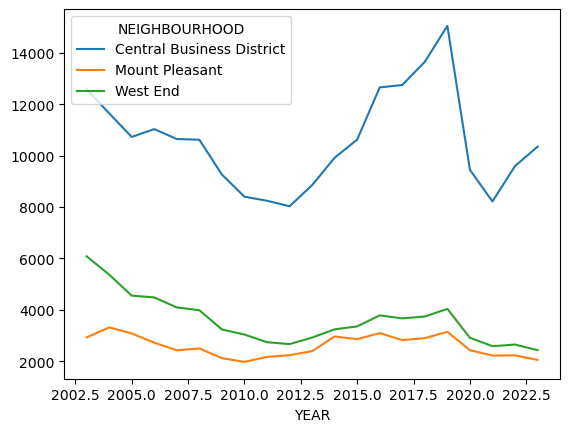

In [33]:

(crime[crime.NEIGHBOURHOOD
    .isin(['Central Business District','West End','Mount Pleasant'])]
    .groupby(['YEAR','NEIGHBOURHOOD'])['NEIGHBOURHOOD']
    .count()
    .reset_index(name='num_of_crimes')
    .pivot(index='YEAR',columns ='NEIGHBOURHOOD' , values='num_of_crimes')
    .plot
    .line()
              )    

In [34]:
import folium
from folium.plugins import HeatMap


# Extract latitude and longitude from the dataframe
locations = crime[['lat', 'lon']].values.tolist()

m = folium.Map(location=[49.2827, -123.1207], zoom_start=12 , tiles='OpenStreetMap')  # Centered on Vancouver
HeatMap(data=crime[['lat', 'lon']].dropna(), radius=8, max_zoom=13).add_to(m)

m.save("crime_density.html")


m = folium.Map(location=[49.285255, -123.123649], zoom_start=12, tiles='OpenStreetMap')

# Add the heatmap layer



<span style="font-size: 16px;color:blue">  ***I'm using Folium to map crime locations, and it's been a truly enjoyable experience – I highly recommend giving it a try!*** </span>

In [35]:
# Base map
map_vancouver = folium.Map(location=[49.2827, -123.1207], zoom_start=12)

# Data for the heatmap (list of lat, lon points)
heat_data = [[row['lat'], row['lon']] for index, row in crime.iterrows()]

HeatMap(heat_data).add_to(map_vancouver)

map_vancouver

<span style="font-size: 16px;color:black"><strong> Concluding this exploratory data analysis,</strong>
 I've also developed an <strong> interactive Power BI report  </strong>to further visualize these insights. 
<p>You can <a href="https://app.powerbi.com/view?r=eyJrIjoiNjM5MjBjNzUtYTliYi00YmMxLTg3OTctNTkxOWZkN2MzYWNkIiwidCI6IjM2Zjk5MzhhLTBiZjQtNGQ4OC1hNTYwLTJiMDdiYThmMGMzNCJ9&pageName=ReportSection9cdf14a6653139ec5a17" target="">explore the report in detail here</a>.</p>

***I encourage you to check it out for a more dynamic view of the data.*** </span>